In [2]:
def scope_center(scope):
    p1 = scope[0]
    xmin, ymin, xmax, ymax = p1[1], p1[0], p1[1], p1[0]
    for sc in scope:
        if sc[0] < ymin:
            ymin = sc[0]
        if sc[1] < xmin:
            xmin = sc[1]
        if sc[0] > ymax:
            ymax = sc[0]
        if sc[1] > xmax:
            xmax = sc[1]
    xcenter = (xmin + xmax) / 2
    ycenter = (ymin + ymax) / 2
    return [ycenter, xcenter]
    
def read_analysis_txt(fname, printInfo=True):
    panel_num = 0
    pool_num = 0
    panel_list = []
    pool_list = []
    with open(fname, 'r') as f:
        lines = f.readlines()

        for line in lines:
            line = line.split(',')
            if len(line) == 1:
                continue
            else:
                fname, bboxes = line[0], line[1:]
                for box_indx in range(0, len(bboxes), 4):
                    label = bboxes[box_indx]
                    if label == 'panel':
                        panel_num += 1
                        panel_list.append(bboxes[box_indx: box_indx+4])
                    elif label == 'pool':
                        pool_num += 1
                        pool_list.append(bboxes[box_indx: box_indx+4])
    
    if printInfo:
        print('panel num: %d' %panel_num)
        print('pool num: %d' %pool_num)
        print('total target: %d' %(panel_num + pool_num))

    return panel_list, pool_list

def get_relative_point(target, point, ratio=100000):
    lat = (target[0] - point[0]) * ratio
    lon = (point[1] - target[1]) * ratio
    return [lat, lon]




### ONLY show 1 / 2 dataset

In [6]:
panel_list, pool_list = read_analysis_txt(analysis_path)
random.shuffle(panel_list)
panel_list = panel_list[:int(0.5*len(panel_list))]
scope = [[-32.208, 115.866], [-32.068, 115.866], [-32.068, 116.033], [-32.208, 116.033]]
[latitude, longitude] = scope_center(scope)
print('center location:', latitude, longitude)

panel num: 36792
pool num: 16111
total target: 52903
center location: -32.138 115.9495


# Visualize the scope 

In [8]:
poly_scope = [[-32.208, 115.866], [-32.068, 115.866], [-32.068, 116.033], [-32.159, 116.033], [-32.160, 115.945], [-32.208, 115.946]]
san_map = folium.Map(location=[latitude, longitude], zoom_start=12, tiles='Stamen Toner')

In [9]:
folium.vector_layers.Polygon(poly_scope, fill=True, color='gray').add_to(san_map)
folium.vector_layers.Polygon(scope, fill=True, color='black').add_to(san_map)
# show left top and right bottom 
folium.Marker(
    location = scope[1],
    popup='left top - scope[1]',
    icon = folium.Icon(icon='info-sign', icon_color='red', color='black')
).add_to(san_map)
folium.Marker(
    location = scope[3],
    popup='right bottom - scope[3]',
    icon = folium.Icon(icon='info-sign', icon_color='orange', color='black')
).add_to(san_map)
for i, loc in enumerate([scope[1], scope[3]]):
    folium.CircleMarker(
        location=loc,
        radius=10,
        popup='{}'.format(['left top' if i==0 else 'right bottom'][0]),
        color='{}'.format(['red' if i==0 else 'orange'][0]),
        fill=True,
    ).add_to(san_map)
san_map

# Visualize the position of `6000` panels

In [10]:
select = 6000
panel_map = folium.Map(location=[latitude, longitude], zoom_start=12, tiles='Stamen Toner')
folium.vector_layers.Polygon(poly_scope, fill=True, color='gray').add_to(panel_map)
# visualize part of panel
part_panel_list = copy.deepcopy(panel_list)
random.shuffle(part_panel_list)
part_panel_list = part_panel_list[:select]
for panel in part_panel_list:
    lat, lon = float(panel[1]), float(panel[2])
    loc = [lat, lon]
    folium.CircleMarker(
        location=loc,
        radius=3,
        popup='panel',
        color='yellow',
        fill=True,
        fill_color='red',
        fill_opacity=0.8
    ).add_to(panel_map)
    
panel_map

In [11]:
relative_panel_list = []
max_lat = 0
max_lon = 0
for panel in panel_list:
    label, lat, lon, prob = panel
    [lat, lon] = get_relative_point(scope[1], [float(lat), float(lon)])
    if lat > max_lat:
        max_lat = lat
    if lon > max_lon:
        max_lon = lon
    relative_panel_list.append([label, lat, lon, float(prob)])
print('relative Image size:', int(max_lat), int(max_lon))


relative Image size: 13908 16677


## Draw `MapArray` (MapArray visualized all panels)

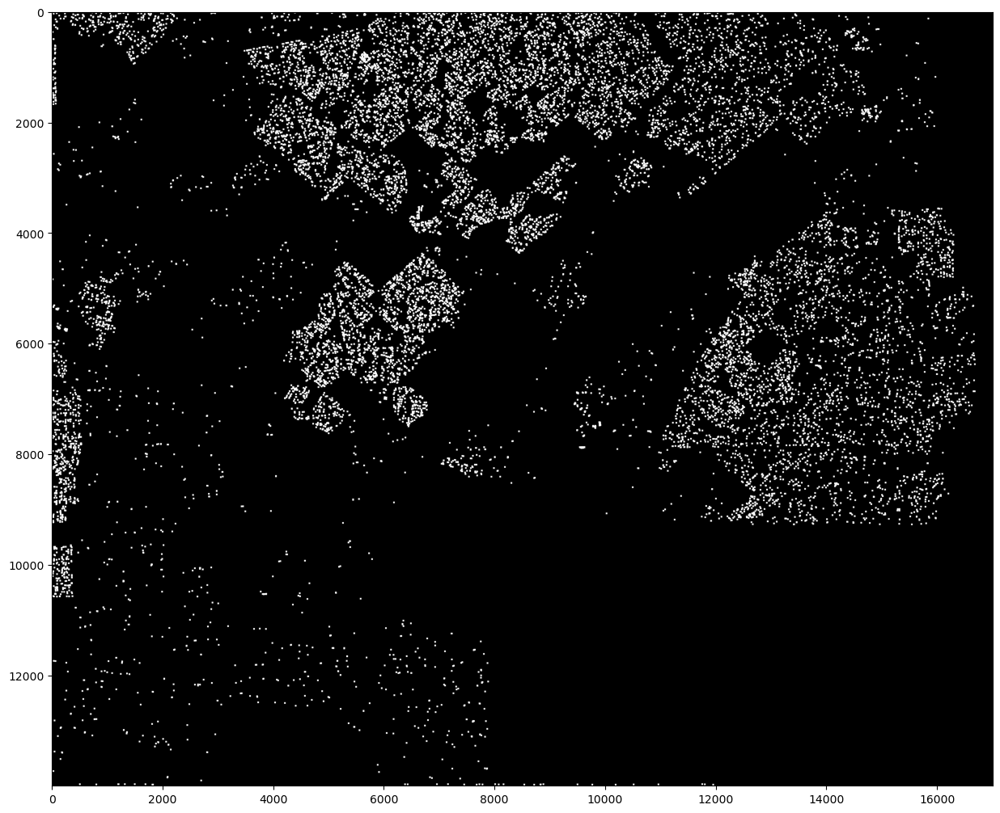

In [12]:
w, h = 14000, 17000
radius = 15
MapArray = np.zeros(shape=[14000, 17000, 3], dtype=np.uint8)
relative_loc_list = []
for panel in relative_panel_list:
    lat, lon = int(panel[1]), int(panel[2])
    relative_loc_list.append([lat, lon])
    MapArray[lat-radius:lat+radius, lon-radius: lon+radius] = 255

plt.figure(figsize=(15, 20))
plt.imshow(MapArray)
plt.show()

## Using KMeans to cluster, `K = 15`

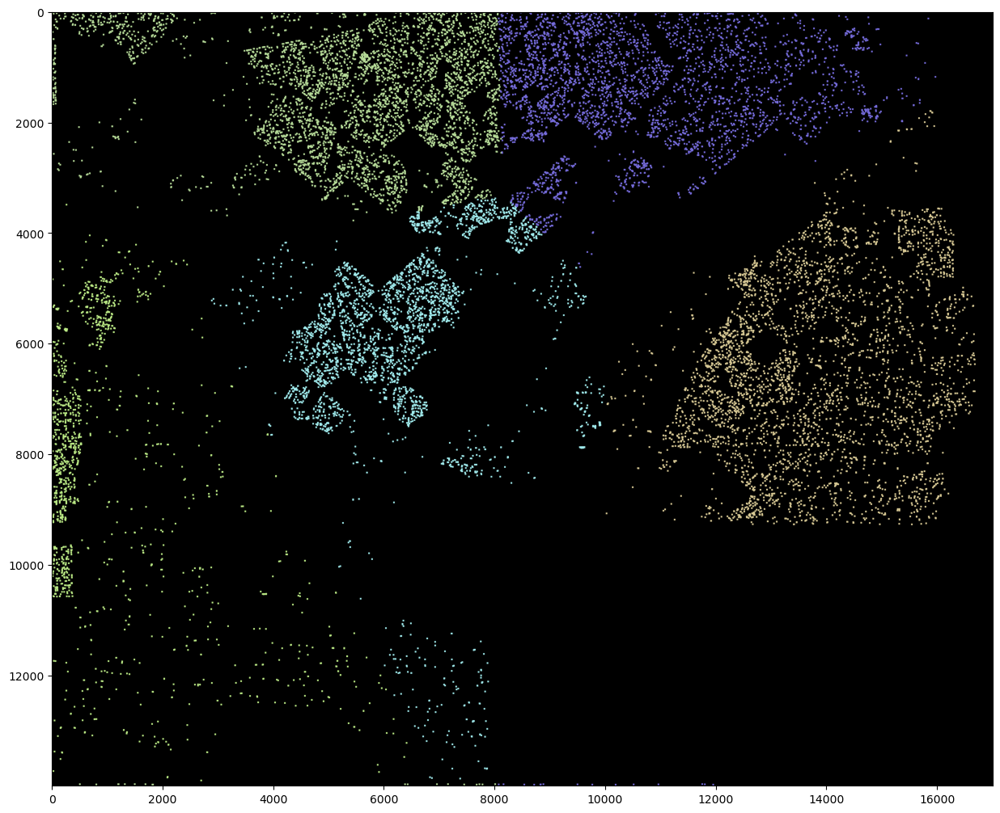

In [13]:
IterSteps = 100
K = 5
relative_loc_list = np.array(relative_loc_list)
X = relative_loc_list

C, L, minIndxList = K_Means.Marko_KMeans(K, X, IterSteps)

random_color = (np.random.random((K, 3)) * 0.6 + 0.4).tolist()
KMeansMapArray = np.zeros(shape=[14000, 17000, 3])

for loc, cls in zip(relative_loc_list, minIndxList):
    lat, lon = loc
    KMeansMapArray[lat-radius:lat+radius, lon-radius: lon+radius, :] = np.array(random_color[cls]) * 255

KMeansMapArray = np.clip(KMeansMapArray, 0, 255).astype(np.uint)

plt.figure(figsize=(15, 20))
plt.imshow(KMeansMapArray)
plt.show()

## Convert relative position to absolute position

In [14]:
def get_lat_lon_from_relative_loc(left_top, right_bottom, loc_list, image_size):
    # left_top: [-32.068, 115.866] right_bottom: [-32.208, 116.033]
    h_degree = right_bottom[0] - left_top[0]
    w_degree = right_bottom[1] - left_top[1]
    h, w = image_size
    abs_loc_list = []
    for loc in loc_list:
        h_ratio = loc[0] / h
        w_ratio = loc[1] / w
        abs_lat = left_top[0] + h_degree * h_ratio
        abs_lon = left_top[1] + w_degree * w_ratio
        abs_loc_list.append([abs_lat, abs_lon])
    return abs_loc_list

    
abs_centers = get_lat_lon_from_relative_loc(scope[1], scope[3], C, [w, h])


## show grid center
## `Markers in the map are the recommended power grid construction site.`

In [15]:
color_options = ['pink', 'lightblue', 'purple', 'beige',
                 'lightgreen', 'green', 'darkgreen', 
                 'blue', 'cadetblue', 'darkred',
                 'orange',  'yellow', 'lightgray',
                 'white', 'gray', 'red']

for i, loc in enumerate(abs_centers):
    # random.shuffle(color_options)
    color = color_options[i]
    folium.Marker(
        location = loc,
        popup='grid center {} '.format(i),
        icon = folium.Icon(icon='info-sign', icon_color=color, color='black')
    ).add_to(san_map)
san_map

## Solar panels of different colors are distributed in different regions of power grids
## show clustered panels 

In [16]:
for i, panel in enumerate(panel_list):
    grid_center = minIndxList[i]
    lat, lon = float(panel[1]), float(panel[2])
    loc = [lat, lon]
    folium.CircleMarker(
        location=loc,
        radius=3,
        popup='grid_center{}'.format(grid_center),
        color=color_options[grid_center],
        fill=True,
        fill_color='red',
        fill_opacity=0.8
    ).add_to(san_map)
san_map